In [ ]:
import tensorflow as tf
import os

In [ ]:
#magic function for matplotlib graphs. Graphs will be included in notebook next to the code.
%matplotlib inline

In [ ]:
#importing dependencies
from __future__ import print_function, division

from datetime import datetime
from PIL import Image
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler
import numpy as np
import torchvision
from torchvision import datasets, models, transforms
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader
import torchvision.transforms as T
from torchvision.transforms import ToTensor
import matplotlib.pyplot as plt
import time
import os
import copy

plt.ion()   # interactive mode

In [ ]:
!pip install wandb
import wandb
wandb.login(key = "7c87f58b9517c863801c4ebc1ebb01bf9d756c9d")

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.8/6.8 MB 31.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 20.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 289.6/289.6 kB 10.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 6.9 MB/s eta 0:00:00


wandb: W&B API key is configured. Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


True

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#Dataset from drive
DATA_FILE = "/content/drive/MyDrive/APD-20231205T210305Z-001/APD"
train_dataset = "/content/drive/MyDrive/APD-20231205T210305Z-001/APD/Train/"
val_dataset = "/content/drive/MyDrive/APD-20231205T210305Z-001/APD/Validation/"

In [ ]:
#changing the format and structure of the data.
data_transforms = {
    'Train': transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
    'Validation': transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
}

data_dir = DATA_FILE
data_types = ['Train', 'Validation']
image_datasets = {x: datasets.ImageFolder(os.path.join(data_dir, x),
                                          data_transforms[x])
                  for x in data_types}
dataloaders = {x: torch.utils.data.DataLoader(image_datasets[x], batch_size=4,
                                             shuffle=True, num_workers=4)
              for x in data_types}
dataset_sizes = {x: len(image_datasets[x]) for x in data_types}
class_names = image_datasets['Train'].classes


/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


In [ ]:
print("List of Directories:", os.listdir(data_dir))
classes = os.listdir(data_dir + "/Train")
print("List of classes:", classes)

List of Directories: ['Train', 'Validation']
List of classes: ['Linear cracks', 'Fatigue cracks', 'Potholes']


In [ ]:
image_size = 300
batch_size = 128

In [ ]:
train_dataset = ImageFolder(data_dir+'/Train', transform=ToTensor())
val_dataset = ImageFolder(data_dir+'/Validation', transform=ToTensor())

In [ ]:
train_dataset = ImageFolder(data_dir + '/Train', transform=T.Compose([
    T.Resize(image_size),
    T.CenterCrop(image_size),
    T.ToTensor()]))

val_dataset = ImageFolder(data_dir + '/Validation', transform=T.Compose([
    T.Resize(image_size),
    T.CenterCrop(image_size),
    T.ToTensor()]))

In [ ]:
img, label = val_dataset[2]
print(img.shape, label)
img

torch.Size([3, 300, 300]) 0


tensor([[[0.5647, 0.5686, 0.5294,  ..., 0.6078, 0.6118, 0.5922],
         [0.5373, 0.5451, 0.5020,  ..., 0.5843, 0.5961, 0.5725],
         [0.4941, 0.5059, 0.4667,  ..., 0.5490, 0.5725, 0.5490],
         ...,
         [0.4784, 0.5529, 0.5608,  ..., 0.4706, 0.4902, 0.4784],
         [0.5059, 0.5647, 0.5647,  ..., 0.4941, 0.4196, 0.4392],
         [0.5255, 0.5725, 0.5647,  ..., 0.5059, 0.3725, 0.4118]],

        [[0.5647, 0.5686, 0.5294,  ..., 0.6118, 0.6157, 0.5961],
         [0.5373, 0.5451, 0.5020,  ..., 0.5882, 0.6000, 0.5765],
         [0.4941, 0.5059, 0.4667,  ..., 0.5529, 0.5765, 0.5529],
         ...,
         [0.4745, 0.5490, 0.5569,  ..., 0.4667, 0.4863, 0.4745],
         [0.4980, 0.5569, 0.5569,  ..., 0.4902, 0.4157, 0.4353],
         [0.5176, 0.5647, 0.5569,  ..., 0.5020, 0.3686, 0.4078]],

        [[0.6039, 0.6078, 0.5608,  ..., 0.6314, 0.6353, 0.6157],
         [0.5765, 0.5804, 0.5373,  ..., 0.6078, 0.6196, 0.5961],
         [0.5333, 0.5412, 0.5020,  ..., 0.5725, 0.5961, 0.

In [ ]:
import matplotlib.pyplot as plt

def show_example(img, label):
    print('Label: ', train_dataset.classes[label], "("+str(label)+")")
    plt.imshow(img.permute(1, 2, 0))

Label:  Fatigue cracks (0)


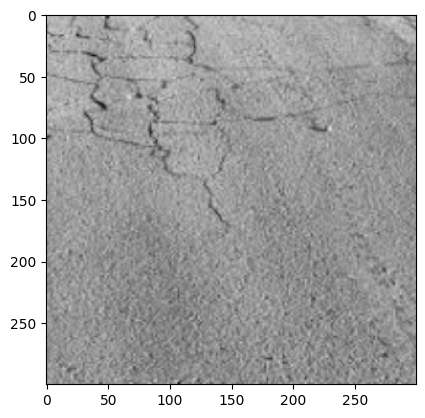

In [ ]:
show_example(*train_dataset[56])

Label:  Potholes (2)


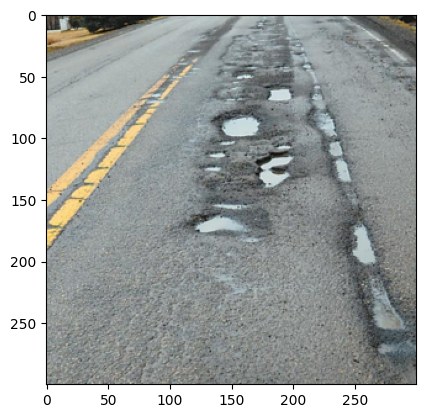

In [ ]:
import random
random_value = random.randint(1000, 2000)
show_example(*train_dataset[random_value])

Label:  Linear cracks (1)


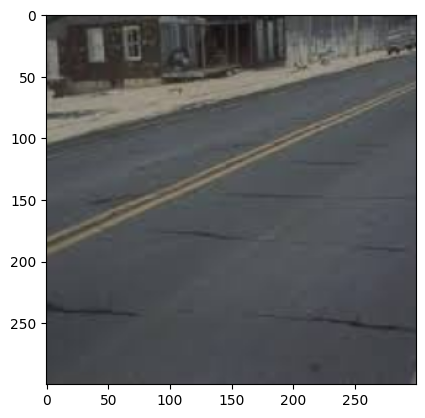

In [ ]:
random_value = random.randint(800, 900)
show_example(*train_dataset[random_value])


In [ ]:
new_batch_size = 12
train_dl = DataLoader(train_dataset, new_batch_size, shuffle=True, num_workers=4, pin_memory=True)
val_dl = DataLoader(val_dataset, new_batch_size*2, num_workers=4, pin_memory=True)

In [ ]:
from torchvision.utils import make_grid

def show_batch(dl):
    for images, labels in dl:
        fig, ax = plt.subplots(figsize=(18, 12))
        ax.set_xticks([]); ax.set_yticks([])
        ax.imshow(make_grid(images, nrow=4).permute(1, 2, 0))
        break

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


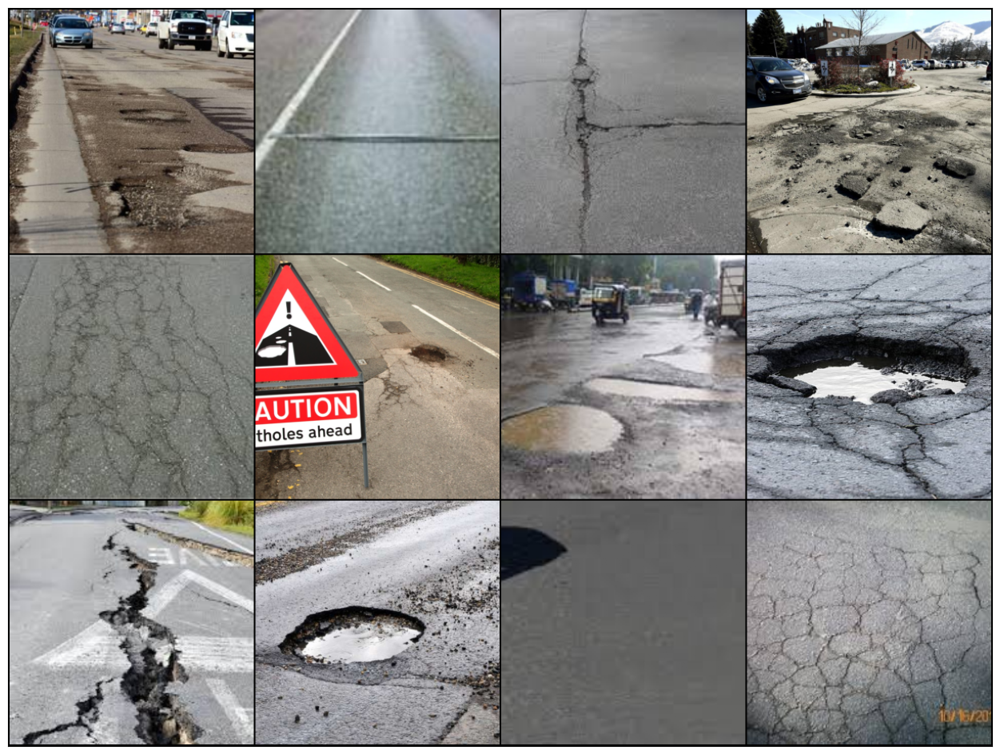

In [ ]:
show_batch(train_dl)

In [ ]:
#tensorboard logging
#to track various metrics such as accuracy and log loss on training or validation set
from torch.utils.tensorboard import SummaryWriter

TB_DIR = f'runs/exp_{datetime.now().strftime("%Y%m%d-%H%M%S")}'
tb_train_writer = SummaryWriter(f'{TB_DIR}/Train')
tb_val_writer = SummaryWriter(f'{TB_DIR}/Validation')

%load_ext tensorboard

In [ ]:
def train_model(model, criterion, optimizer, scheduler, num_epochs=4):
    since = time.time()

    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['Train', 'Validation']:
            if phase == 'Train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0
            running_corrects = 0

            # Iterate over data.
            for inputs, labels in dataloaders[phase]:
                inputs = inputs.to("cuda")
                labels = labels.to("cuda")

                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'Train'):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)

                    # backward + optimize only if in training phase
                    if phase == 'Train':
                        loss.backward()
                        optimizer.step()

                # statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)
            if phase == 'Train':
                scheduler.step()

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects.double() / dataset_sizes[phase]

            if phase == 'Train':
              tb_writer = tb_train_writer
            else:
              tb_writer = tb_val_writer

            tb_writer.add_scalar(f'Loss', epoch_loss, epoch)
            tb_writer.add_scalar(f'Accuracy', epoch_acc, epoch)

            print('{} Loss: {:.4f} Acc: {:.4f}'.format(
                phase, epoch_loss, epoch_acc))

            # deep copy the model
            if phase == 'Validation' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())

        print()

    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(
        time_elapsed // 60, time_elapsed % 60))
    print('Best val Acc: {:4f}'.format(best_acc))

    tb_train_writer.close()
    tb_val_writer.close()

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model

In [ ]:
def imshow(inp, title=None):
    """Imshow for Tensor."""
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)  # pause a bit so that plots are updated

In [ ]:
def visualize_model(model, dataset, num_images=6):
    was_training = model.training
    model.eval()
    images_so_far = 0
    fig = plt.figure()

    with torch.no_grad():
        for i, (inputs, labels) in enumerate(dataloaders[dataset]):
            inputs = inputs.to("cuda")
            labels = labels.to("cuda")

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            for j in range(inputs.size()[0]):
                images_so_far += 1
                ax = plt.subplot(num_images//2, 2, images_so_far)
                ax.axis('off')
                ax.set_title('predicted: {}'.format(class_names[preds[j]]))
                imshow(inputs.cpu().data[j])

                if images_so_far == num_images:
                    model.train(mode=was_training)
                    return
        model.train(mode=was_training)

In [ ]:
model_ft = models.resnet50(pretrained=True)
num_ftrs = model_ft.fc.in_features
# Here the size of each output sample is set to number of classes.
# Alternatively, it can be generalized to nn.Linear(num_ftrs, len(class_names)).
model_ft.fc = nn.Linear(num_ftrs, len(class_names))

model_ft = model_ft.to("cuda")

criterion = nn.CrossEntropyLoss()

# Observe that all parameters are being optimized
optimizer_ft = optim.SGD(model_ft.parameters(), lr=0.001, momentum=0.9)

# Decay LR by a factor of 0.1 every 7 epochs
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_ft, step_size=7, gamma=0.1)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:01<00:00, 73.3MB/s]


In [ ]:
model_ft = train_model(model_ft, criterion, optimizer_ft, exp_lr_scheduler,
                       num_epochs=32)

Epoch 0/31
----------
Train Loss: 0.7008 Acc: 0.7406
Validation Loss: 0.8057 Acc: 0.6861

Epoch 1/31
----------
Train Loss: 0.5315 Acc: 0.8021
Validation Loss: 0.3309 Acc: 0.8681

Epoch 2/31
----------
Train Loss: 0.4658 Acc: 0.8414
Validation Loss: 0.4169 Acc: 0.8631

Epoch 3/31
----------
Train Loss: 0.3808 Acc: 0.8681
Validation Loss: 0.4099 Acc: 0.8731

Epoch 4/31
----------
Train Loss: 0.2820 Acc: 0.9021
Validation Loss: 0.3823 Acc: 0.8815

Epoch 5/31
----------
Train Loss: 0.2575 Acc: 0.9114
Validation Loss: 0.3176 Acc: 0.8898

Epoch 6/31
----------
Train Loss: 0.2243 Acc: 0.9235
Validation Loss: 0.3174 Acc: 0.8848

Epoch 7/31
----------
Train Loss: 0.1541 Acc: 0.9498
Validation Loss: 0.2803 Acc: 0.8965

Epoch 8/31
----------
Train Loss: 0.1236 Acc: 0.9587
Validation Loss: 0.2791 Acc: 0.8998

Epoch 9/31
----------
Train Loss: 0.1172 Acc: 0.9624
Validation Loss: 0.2860 Acc: 0.8998

Epoch 10/31
----------
Train Loss: 0.1171 Acc: 0.9616
Validation Loss: 0.2953 Acc: 0.9032

Epoch 11/

In [ ]:
%tensorboard --logdir='./runs'

<IPython.core.display.Javascript object>

In [ ]:
def check_accuracy(test_loader, model, device):
    num_correct = 0
    total = 0
    model.eval()

    with torch.no_grad():
        for data, labels in test_loader:
            data = data.to(device=device)
            labels = labels.to(device=device)

            outputs = model(data)
            _, predictions = torch.max(outputs, 1)
            num_correct += (predictions == labels).sum()
            total += labels.size(0)
        print(f"Test Accuracy of the model: {float(num_correct)/float(total):.2f}")

def visualize_test_errors(test_loader, model, device):
    model.eval()
    incorrect_examples=[]

    with torch.no_grad():
        for data, labels in test_loader:
            data = data.to(device=device)
            labels = labels.to(device=device)

            outputs = model(data)
            _, predictions = torch.max(outputs, 1)
            idxs_mask = (predictions != labels).view(-1)
            num_true_idxs = idxs_mask.sum()
            if num_true_idxs > 0:
                found_falses = data[idxs_mask].cpu().numpy()
                false_predictions = predictions[idxs_mask].cpu().numpy()
                false_labels = labels[idxs_mask].cpu().numpy()
                for j in range(found_falses.shape[0]):
                    incorrect_examples.append((found_falses[j,:,:,:],
                                               false_predictions[j],
                                               false_labels[j]))
    return incorrect_examples

def show_image(inp, title=None):
    inp = inp.transpose((1, 2, 0))
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)

def visualize_error_images(error_examples):
    for img, prediction, label in error_examples:
        print(f'gt label: {class_names[label]}')
        print(f'prediction: {class_names[prediction]}')
        show_image(img.squeeze())

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Test Accuracy of the model: 0.91
gt label: Fatigue cracks
prediction: Linear cracks


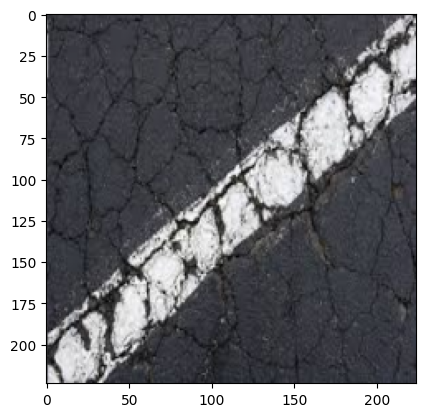

gt label: Linear cracks
prediction: Fatigue cracks


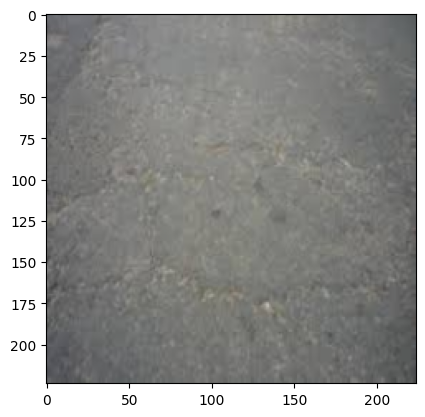

gt label: Linear cracks
prediction: Fatigue cracks


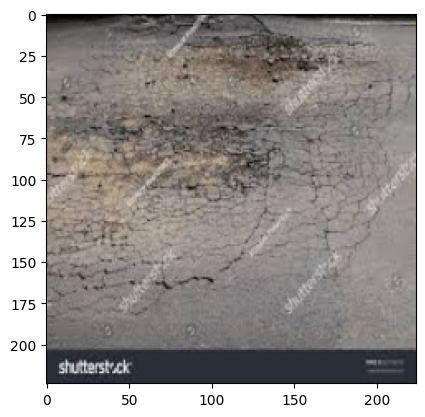

gt label: Linear cracks
prediction: Fatigue cracks


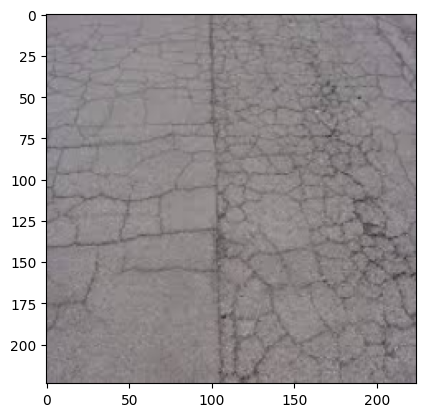

gt label: Fatigue cracks
prediction: Linear cracks


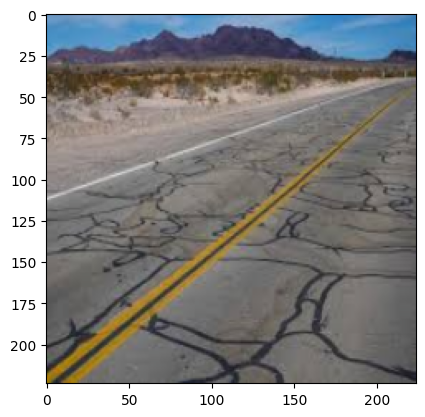

gt label: Fatigue cracks
prediction: Linear cracks


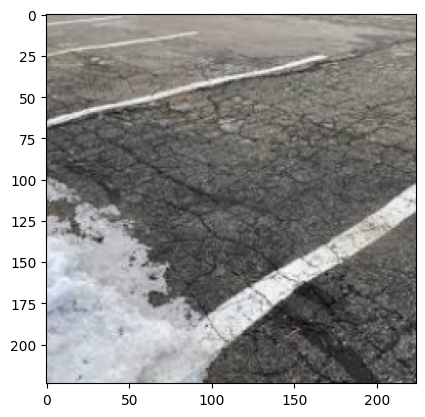

gt label: Potholes
prediction: Fatigue cracks


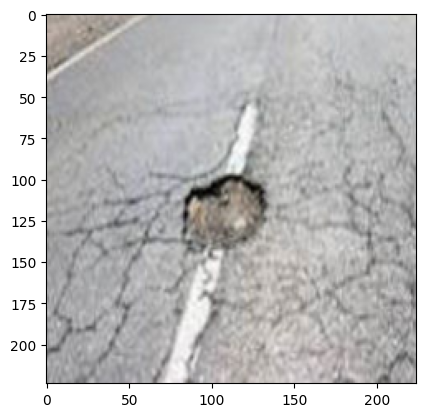

gt label: Fatigue cracks
prediction: Linear cracks


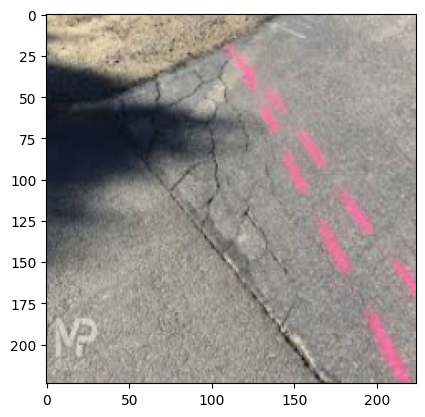

gt label: Fatigue cracks
prediction: Linear cracks


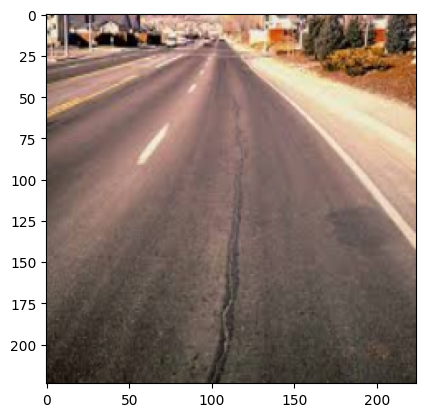

gt label: Linear cracks
prediction: Fatigue cracks


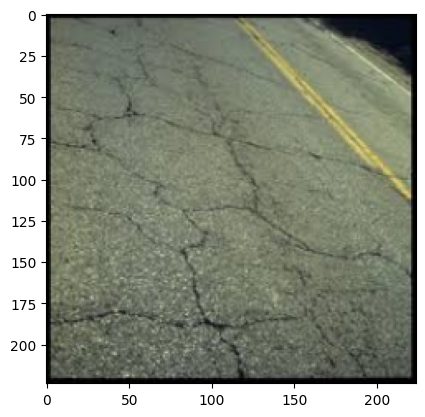

gt label: Fatigue cracks
prediction: Linear cracks


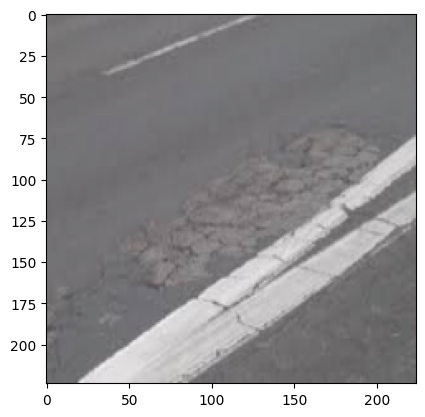

gt label: Fatigue cracks
prediction: Linear cracks


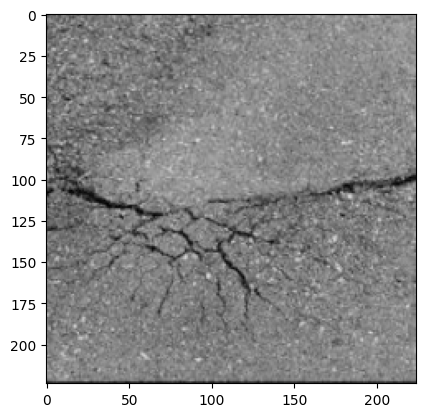

gt label: Fatigue cracks
prediction: Linear cracks


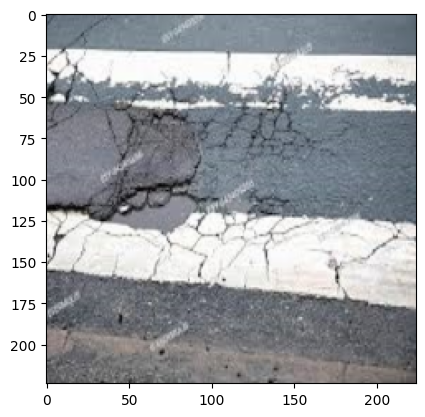

gt label: Fatigue cracks
prediction: Linear cracks


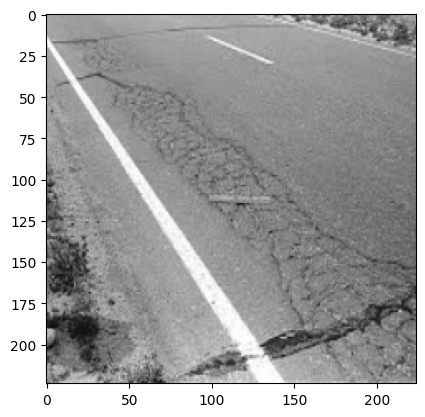

gt label: Linear cracks
prediction: Potholes


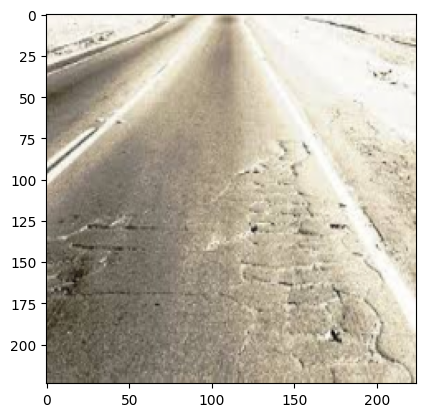

gt label: Potholes
prediction: Fatigue cracks


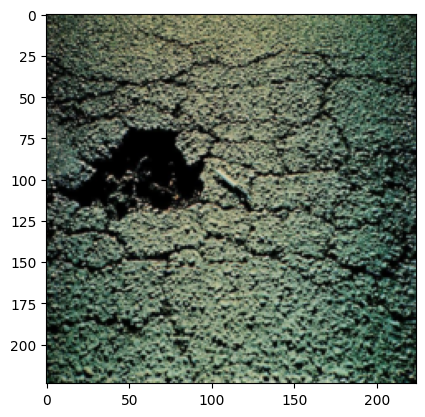

gt label: Linear cracks
prediction: Fatigue cracks


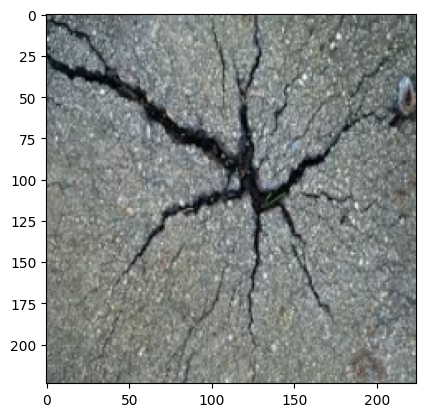

gt label: Fatigue cracks
prediction: Linear cracks


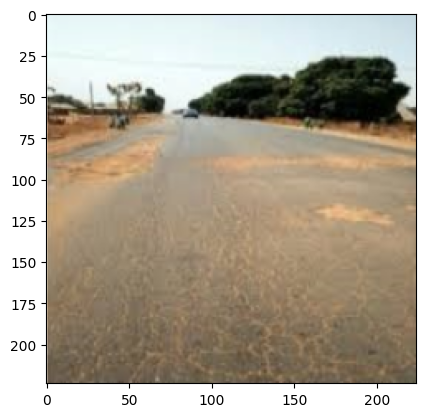

gt label: Potholes
prediction: Fatigue cracks


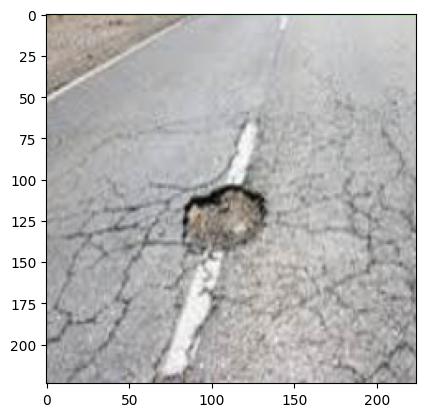

gt label: Linear cracks
prediction: Potholes


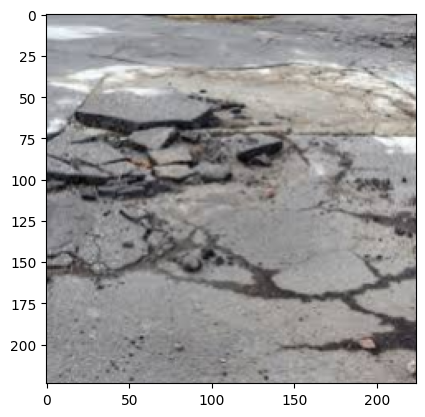

gt label: Linear cracks
prediction: Fatigue cracks


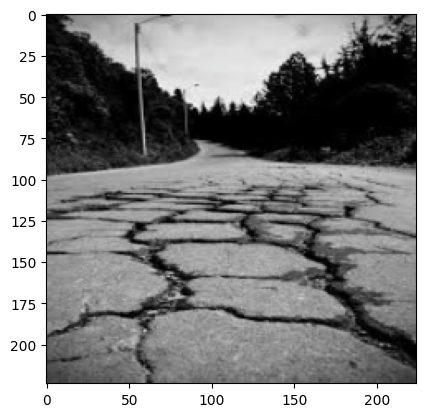

gt label: Fatigue cracks
prediction: Linear cracks


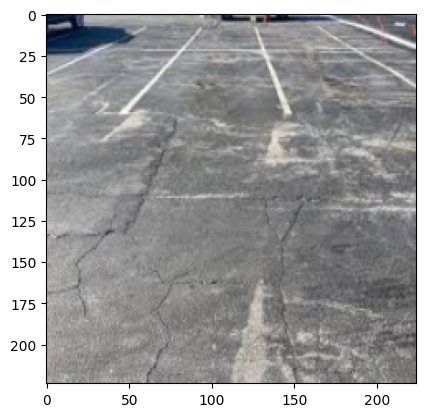

gt label: Linear cracks
prediction: Fatigue cracks


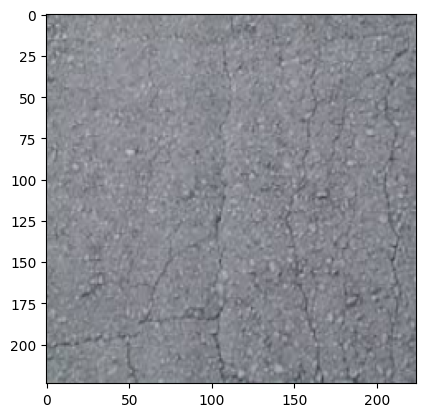

gt label: Fatigue cracks
prediction: Linear cracks


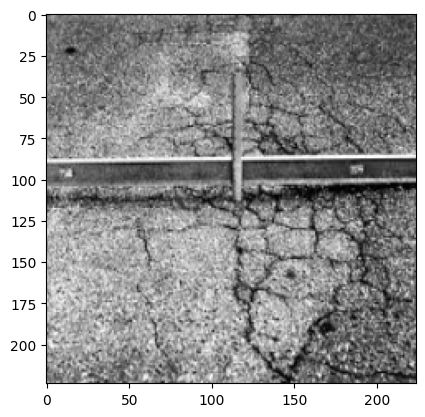

gt label: Linear cracks
prediction: Fatigue cracks


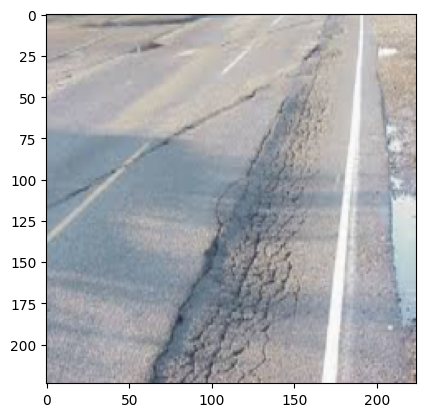

gt label: Fatigue cracks
prediction: Linear cracks


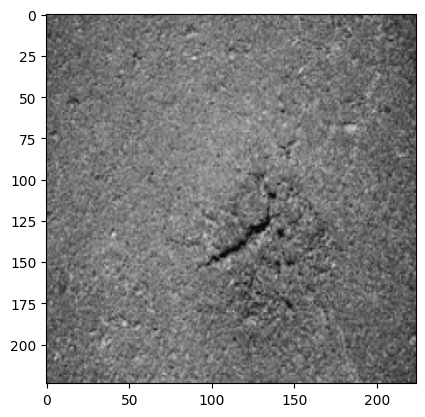

gt label: Fatigue cracks
prediction: Potholes


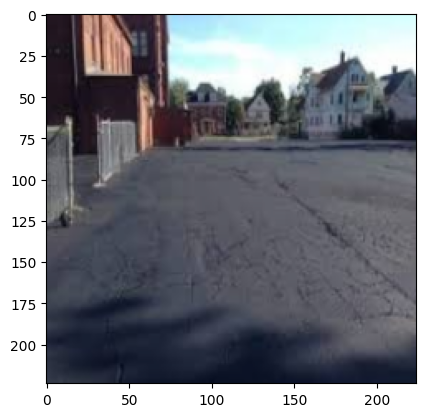

gt label: Fatigue cracks
prediction: Linear cracks


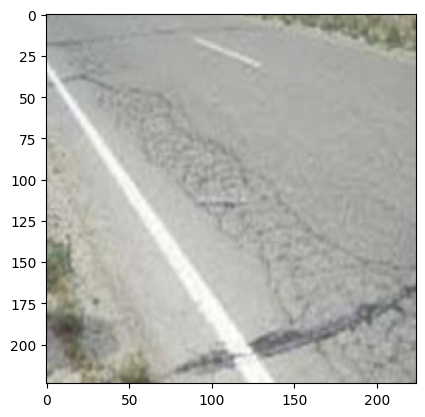

gt label: Fatigue cracks
prediction: Linear cracks


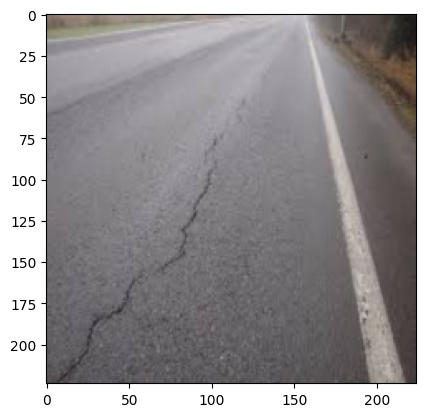

gt label: Fatigue cracks
prediction: Linear cracks


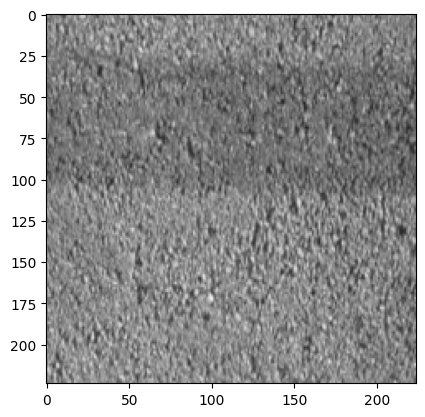

gt label: Fatigue cracks
prediction: Potholes


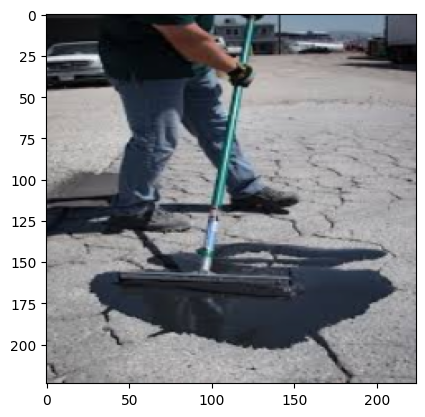

gt label: Fatigue cracks
prediction: Potholes


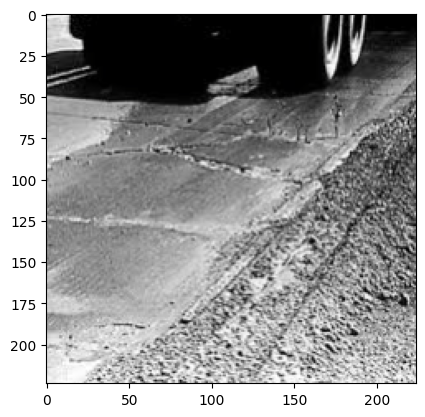

gt label: Linear cracks
prediction: Fatigue cracks


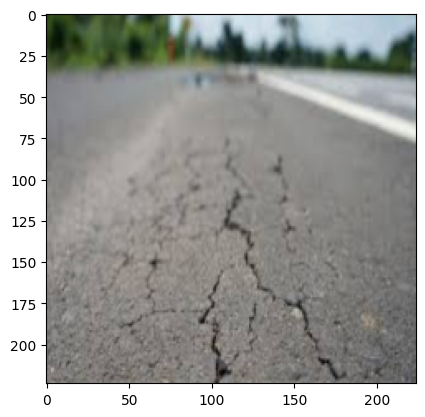

gt label: Linear cracks
prediction: Fatigue cracks


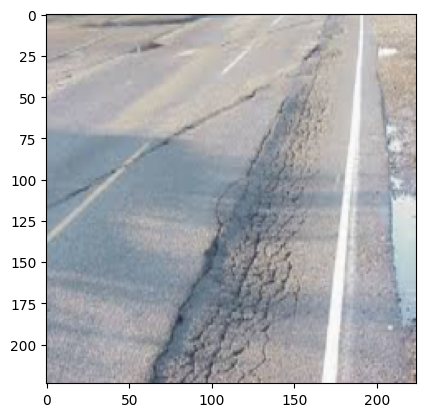

gt label: Linear cracks
prediction: Fatigue cracks


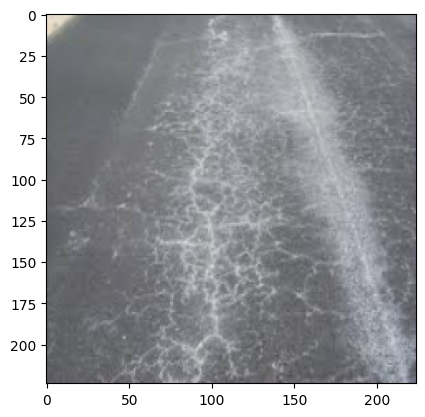

gt label: Linear cracks
prediction: Fatigue cracks


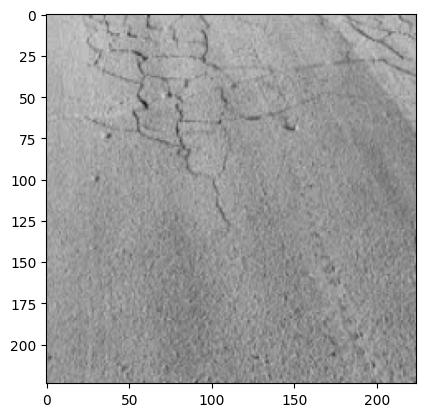

gt label: Fatigue cracks
prediction: Linear cracks


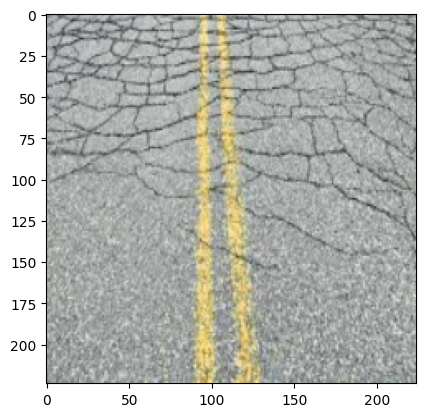

gt label: Fatigue cracks
prediction: Linear cracks


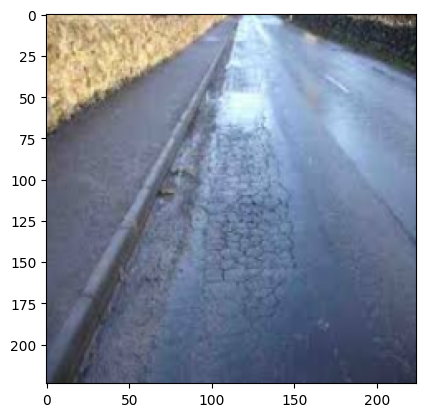

gt label: Linear cracks
prediction: Fatigue cracks


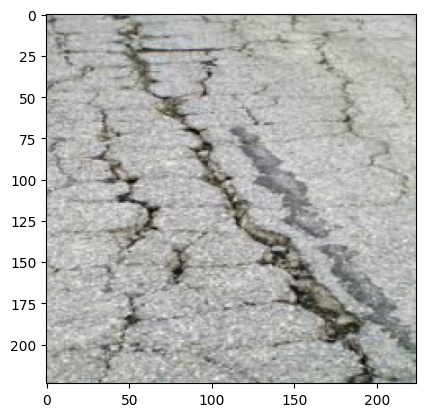

gt label: Fatigue cracks
prediction: Linear cracks


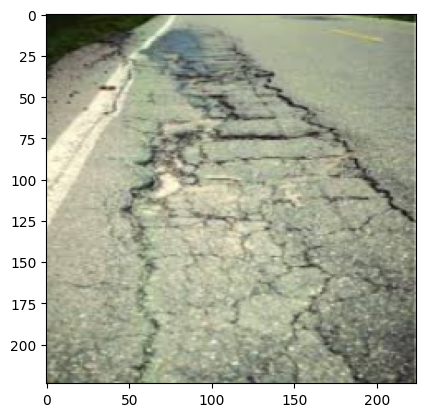

gt label: Fatigue cracks
prediction: Linear cracks


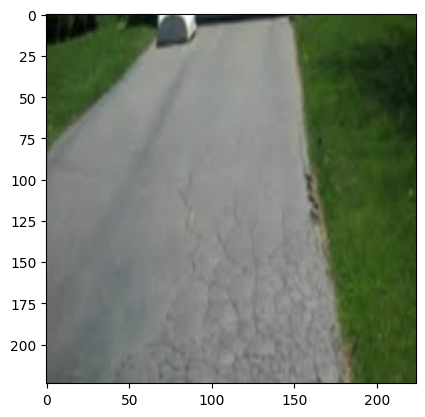

gt label: Fatigue cracks
prediction: Linear cracks


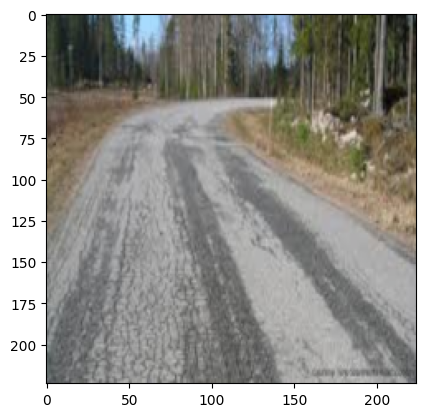

gt label: Fatigue cracks
prediction: Linear cracks


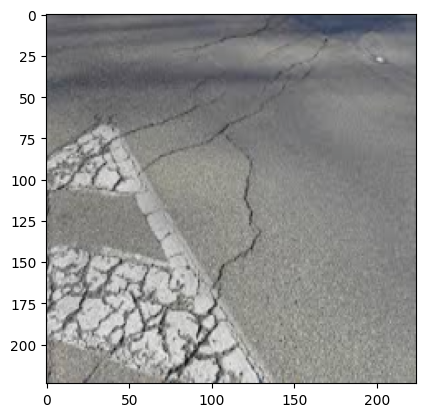

gt label: Fatigue cracks
prediction: Linear cracks


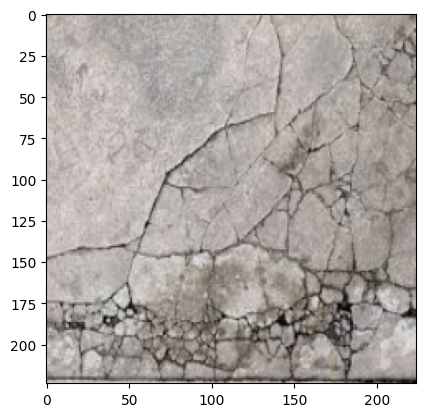

gt label: Fatigue cracks
prediction: Linear cracks


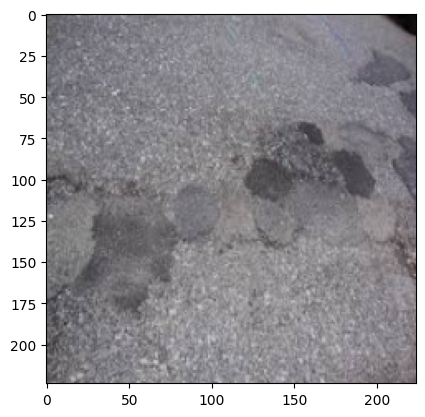

gt label: Linear cracks
prediction: Fatigue cracks


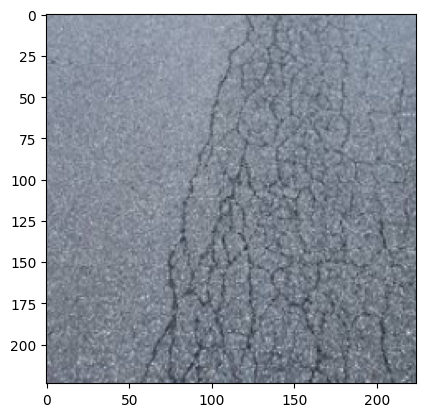

gt label: Fatigue cracks
prediction: Linear cracks


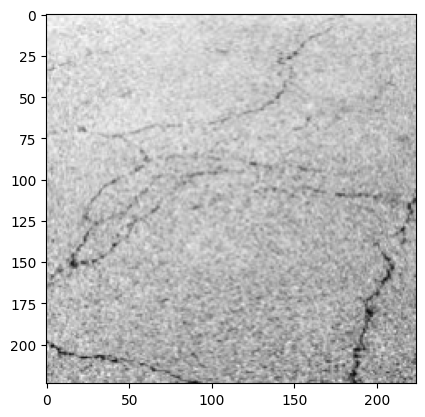

gt label: Linear cracks
prediction: Fatigue cracks


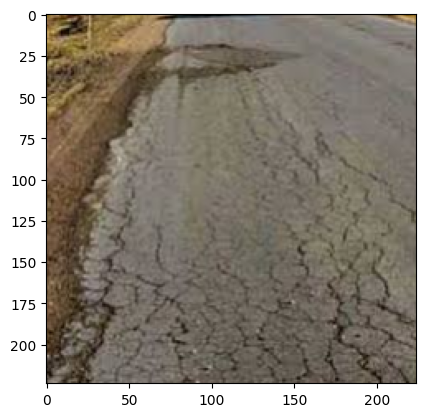

gt label: Linear cracks
prediction: Fatigue cracks


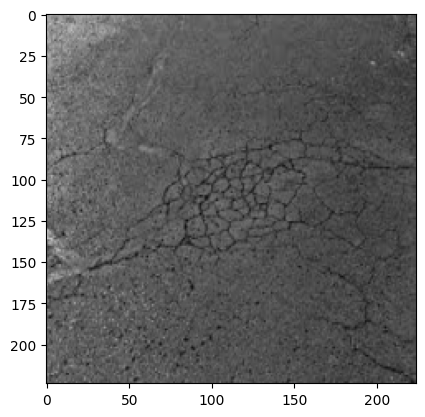

gt label: Linear cracks
prediction: Potholes


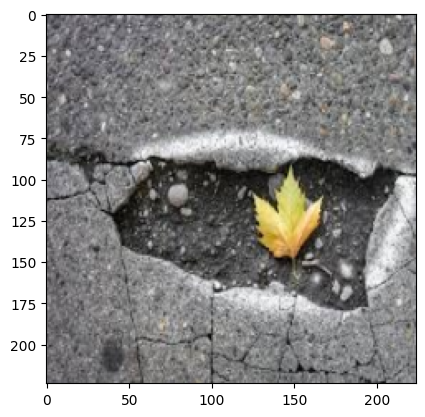

gt label: Linear cracks
prediction: Fatigue cracks


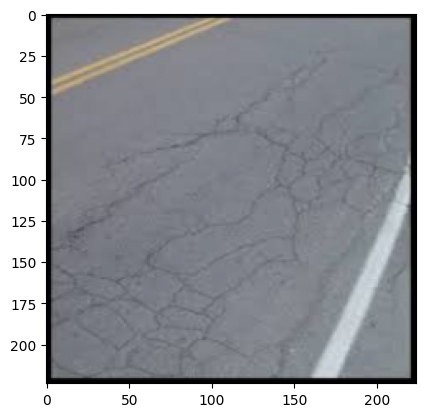

gt label: Linear cracks
prediction: Fatigue cracks


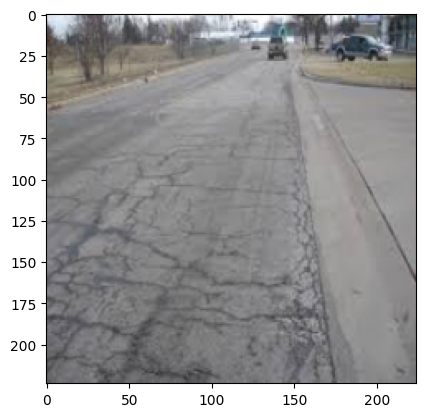

gt label: Linear cracks
prediction: Fatigue cracks


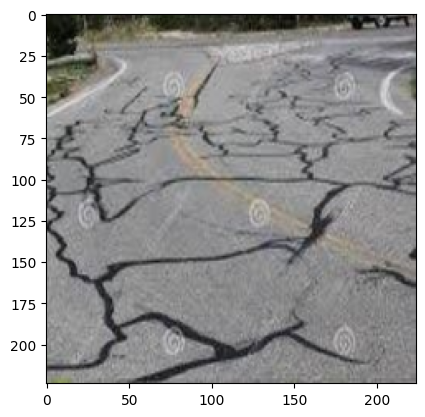

gt label: Linear cracks
prediction: Fatigue cracks


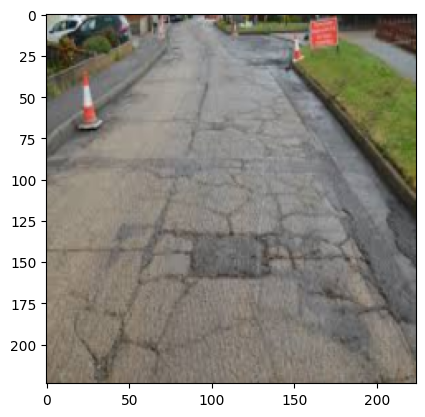

In [ ]:
error_images = check_accuracy(dataloaders['Validation'], model_ft, "cuda")

error_examples = visualize_test_errors(dataloaders['Validation'], model_ft, "cuda")
#shows some prediction errors. Might show nothing if prediction is 100%
visualize_error_images(error_examples)

In [ ]:
torch.save(model_ft, 'model-PDD-pytorch-res50-92accuracy.pt')